# Кластеризация

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import Image

## Постановка задачи

Пусть у нас есть множество объектов $X$, но отсутствует какое-либо множество $y$.

Наша задача: как-то логично разделить объекты $X$ на разные **кластеры**. 

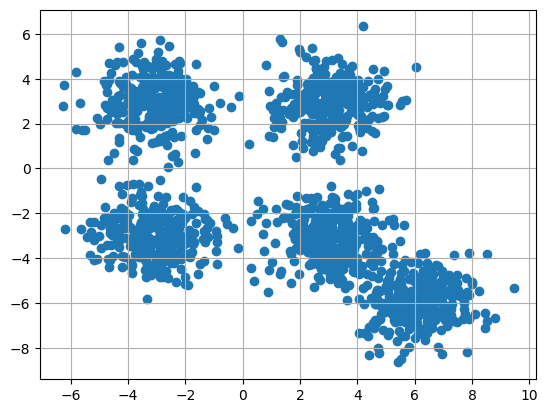

In [2]:
# Generate some data
N = 300

X1 = np.random.randn(N,2) + np.array([3,3])
X2 = np.random.randn(N,2) + np.array([-3,-3])
X3 = np.random.randn(N,2) + np.array([-3,3])
X4 = np.random.randn(N,2) + np.array([3,-3])
X6 = np.random.randn(N,2) + np.array([6,-6])


X5_example = np.vstack([X1, X2, X3, X4, X6])
plt.scatter(X5_example[:,0], X5_example[:,1])
plt.grid()

## K-means

Пусть мы знаем, что кластеров должно получиться $k$, давайте будем проводить следующий алгоритм:

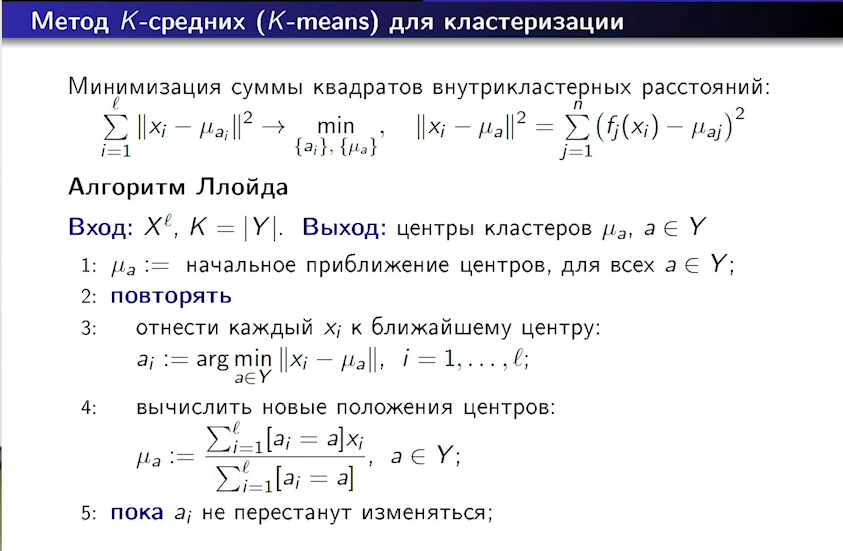

In [3]:
Image('images/kmeans.png', width=1000)

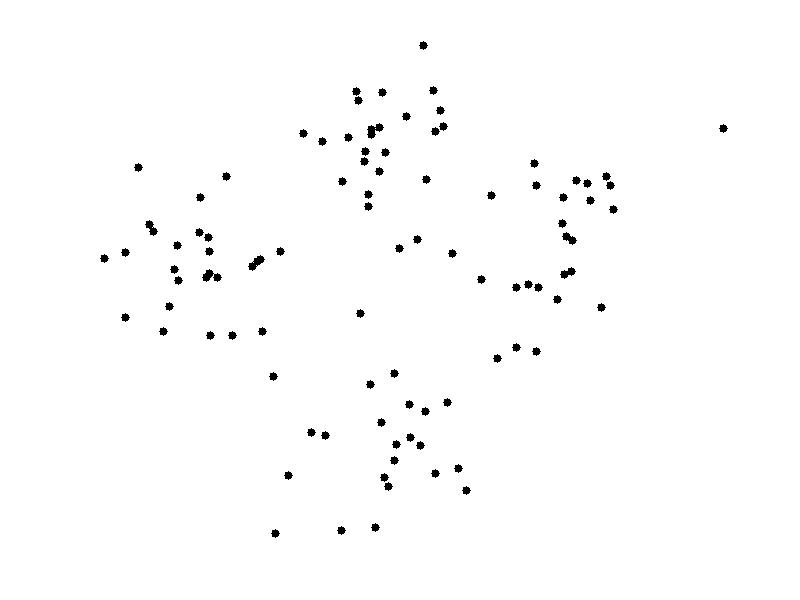

In [4]:
Image('images/kmeans.gif', width=1000)

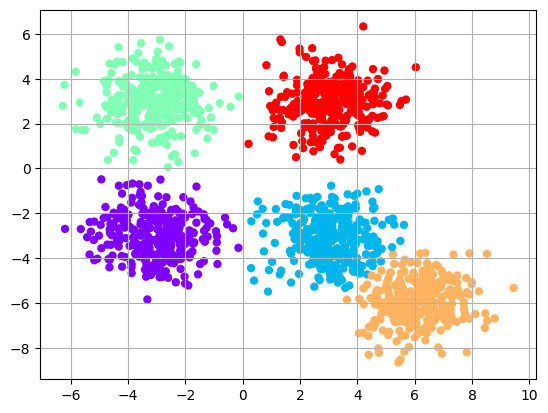

In [5]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=5, n_init=10).fit(X5_example)
labels = kmeans.labels_
plt.scatter(X5_example[:,0],X5_example[:,1], c = labels, cmap='rainbow', edgecolors= 'none')
plt.grid()

In [6]:
kmeans.predict([[0, 0], [12, 3]])

array([4, 4], dtype=int32)

In [7]:
kmeans.cluster_centers_


array([[-3.04400106, -3.03784533],
       [ 3.02976086, -3.09262521],
       [-3.08605433,  3.03388873],
       [ 6.08060269, -5.96988784],
       [ 3.03927244,  2.99189678]])

## Проблемы kmeans

**Нужно знать число кластеров.**

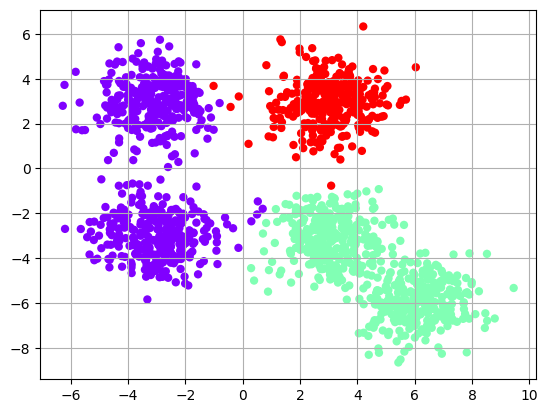

In [8]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=3, n_init=10).fit(X5_example)
labels = kmeans.labels_
plt.scatter(X5_example[:,0],X5_example[:,1], c = labels, cmap='rainbow', edgecolors= 'none')
plt.grid()

**Хорош для разделения "концентрированных" кластеров, но так себе дружит с геометрией и локальными свойствами кластеров**

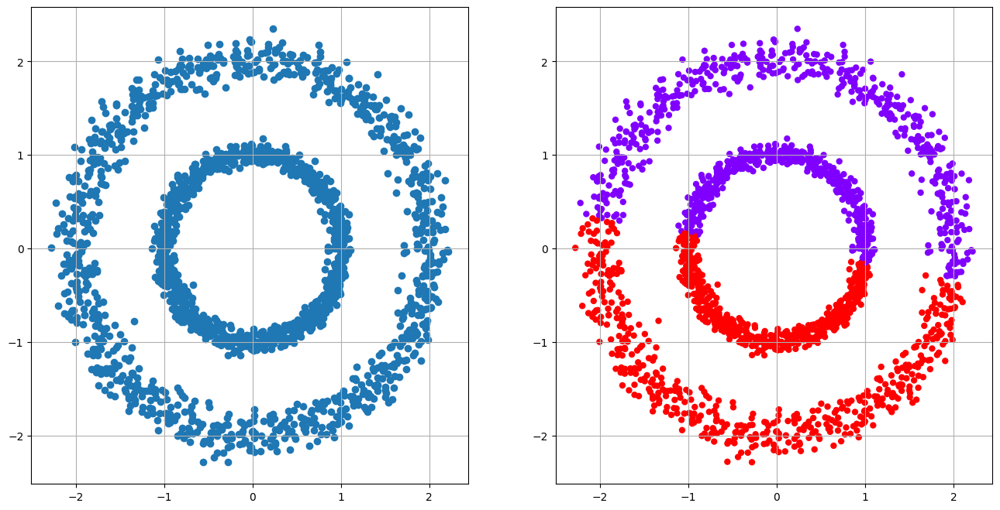

In [9]:
from random import gauss

num_samples = 1000
theta = np.linspace(0, 2*np.pi, num_samples)

r1 = 1
r2 = 2

rng = np.random.RandomState(1)

circle = np.hstack([np.cos(theta).reshape((-1, 1)) + (rng.randn(num_samples)[:,np.newaxis] / 16), 
                    np.sin(theta).reshape((-1, 1)) + (rng.randn(num_samples)[:,np.newaxis] / 16)])
lil = r1 * circle
big = r2 * circle
X_circle = np.vstack([lil, big])
# plots
fig, (ax0, ax1) = plt.subplots(1,2, figsize=(16,8))
ax0.scatter(X_circle[:,0],X_circle[:,1])
ax0.grid()

model = KMeans(n_clusters=2, n_init=10).fit(X_circle)
labels = model.labels_
ax1.scatter(X_circle[:,0],X_circle[:,1], c = labels, cmap='rainbow', edgecolors= 'none')
ax1.grid()

plt.show()

## DBSCAN

1. Выберем произвольную неразмеченную точку и построим некоторую $\varepsilon$-окрестность.

2. Если в эту эпсилон окрестность попало $m$ и более точек (пусть 3), то мы считаем область плотной и помечаем нашу точку некоторым кластером, а соседей добавляем в очередь. Иначе - помечаем точку шумом.

3. Если очередь не пустая, берем соседа и делаем аналогичную операцию как в шаге 1. 

4. Если очередь пустая, мы фиксируем кластер. И выбираем произвольную из оставшихся точку (не помеченную шумом) и повторяем шаг 1.

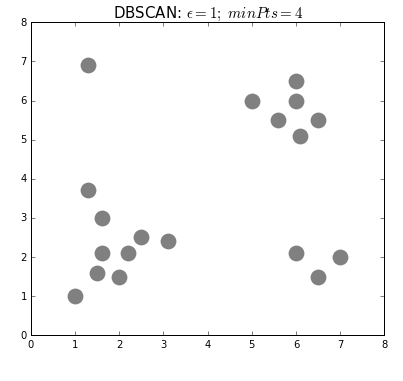

In [10]:
Image('images/dbscan.gif', width=750)

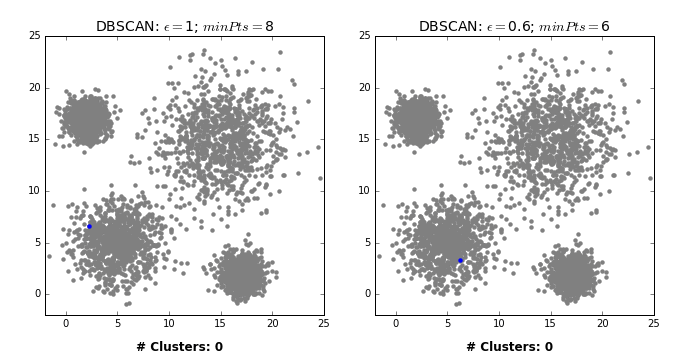

In [11]:
Image('images/DBSCAN_search.gif')

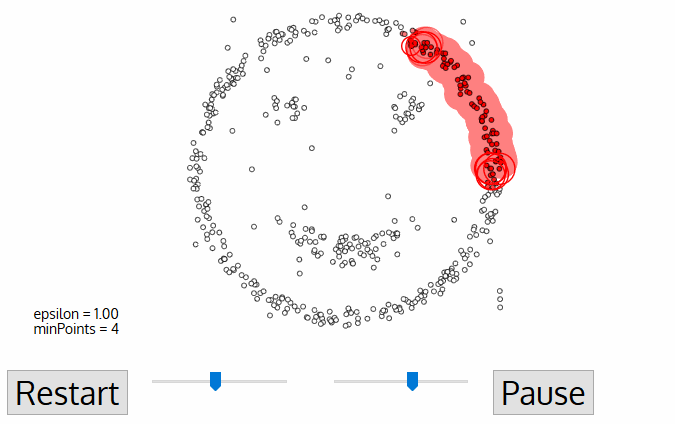

In [12]:
Image('images/smilecluster.gif')

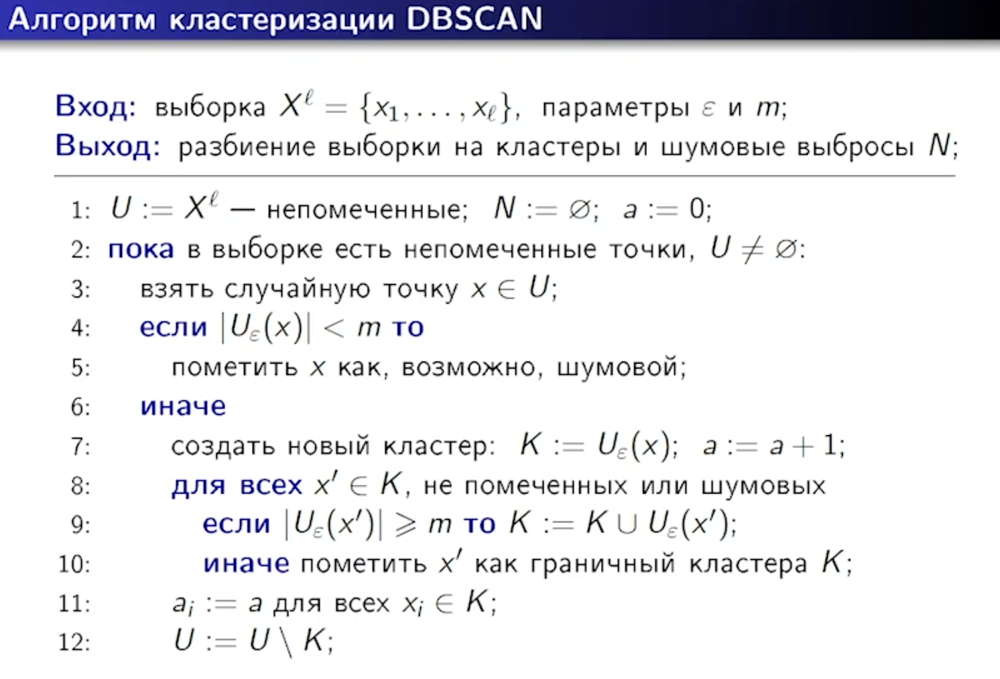

In [13]:
Image('images/dbscan1.png', width=1000)

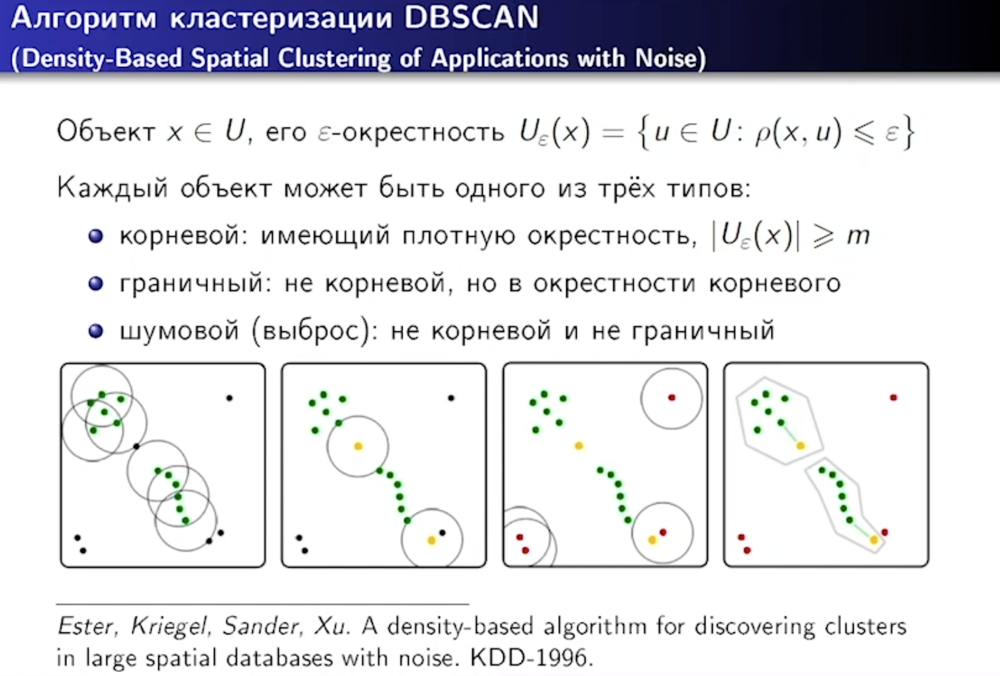

In [14]:
Image('images/dbscan2.png', width=1000)

**DBScan справляется с концентрическими окружностями**

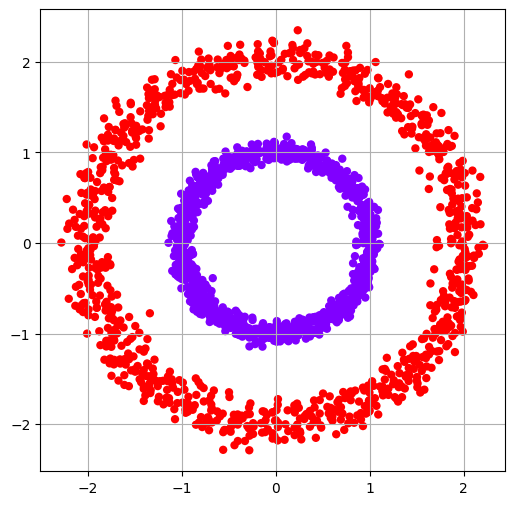

In [15]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=0.3, min_samples=4).fit(X_circle)

labels = dbscan.labels_

plt.figure(figsize=(6,6))
plt.scatter(X_circle[:,0],X_circle[:,1], c = labels, cmap='rainbow', edgecolors= 'none')
plt.grid()

**Но требует аккуратного подбора $\varepsilon$, чтобы не счесть шумом разреженные области и не слить несколько кластеров в один**

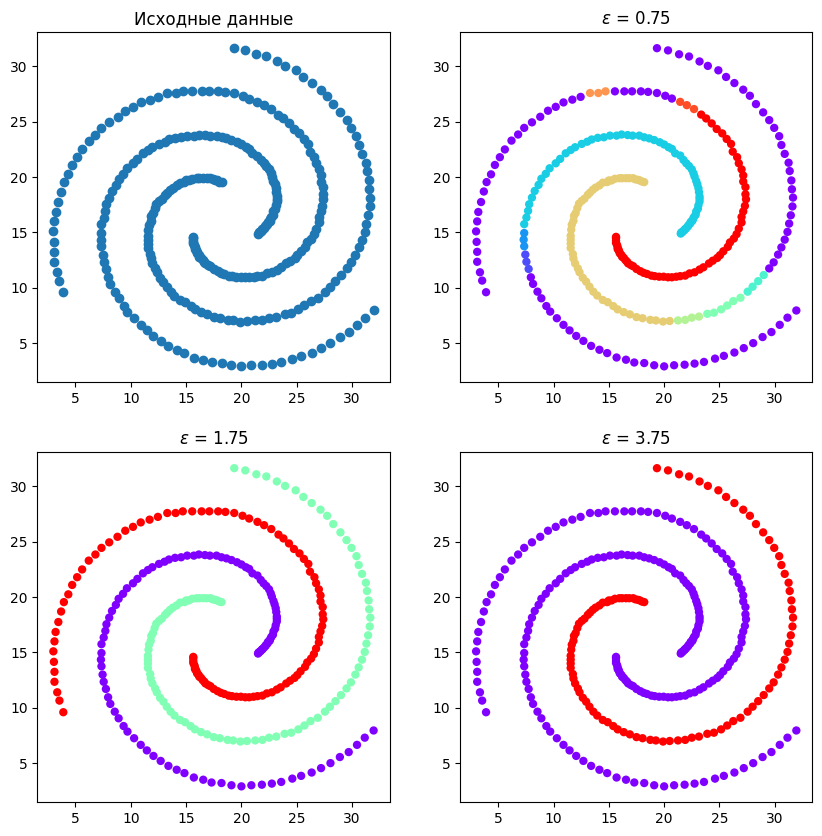

In [16]:
spiral = pd.read_csv('data/spiral.txt', sep='\t', names = ['x', 'y', 'class'])

X_spiral = spiral[['x', 'y']].values


fig, axes = plt.subplots(2,2, figsize=(10,10))
axes = axes.flatten()

axes[0].scatter(X_spiral[:,0], X_spiral[:,1])
axes[0].set_title('Исходные данные')

def draw_dbscan(ax, eps):
    dbscan = DBSCAN(eps=eps, min_samples=3).fit(X_spiral)
    labels = dbscan.labels_
    clusters = len(np.unique(labels))
    ax.scatter(X_spiral[:,0], X_spiral[:,1], c = labels, cmap='rainbow', edgecolors= 'none')
    ax.set_title(f'$\\varepsilon$ = {eps}')

draw_dbscan(axes[1], 0.75)
draw_dbscan(axes[2], 1.75)
draw_dbscan(axes[3], 3.75)


**Может счесть шумом отдалённые точки кластера**

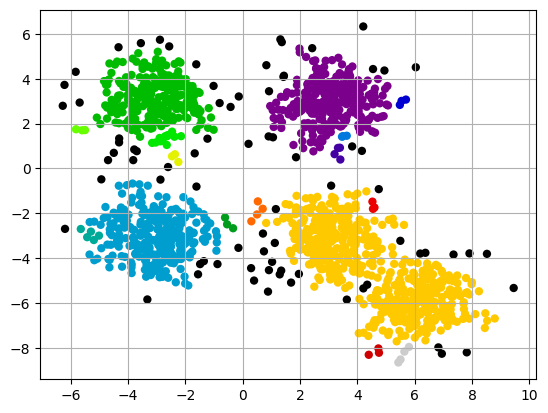

In [17]:
dbscan = DBSCAN(eps=0.4, min_samples=3).fit(X5_example)

labels = dbscan.labels_

plt.scatter(X5_example[:,0],
            X5_example[:,1], c = labels, cmap='nipy_spectral', edgecolors= 'none')
plt.grid()

## Иерархическая кластеризация (Hierarchical clustering)

Иерархическая кластеризация представляет из себя алгоритм, который строит иерархию (дерево) кластеров.

Алгоритм работает так:

Пусть есть некоторое множество объектов $X$
1. Каждому $x_i \in X$ сопоставляется свой собственный кластер $C_i$.
2. Затем два ближайщих кластера сливаются в один.
3. Как только образовался один общий кластер, алгоритм завершает работу.

Таким образом, получили **восходящую** иерархическую кластеризацию, т. к. мы строили дерево снизу-вверх. На самом деле можно проделать всё то же самое, но в другом порядке, т. е. идти от одного общего кластера, содержащего все объекты, к "индивидуальным" кластерам (получится **нисходящая** иеархическая кластеризация).



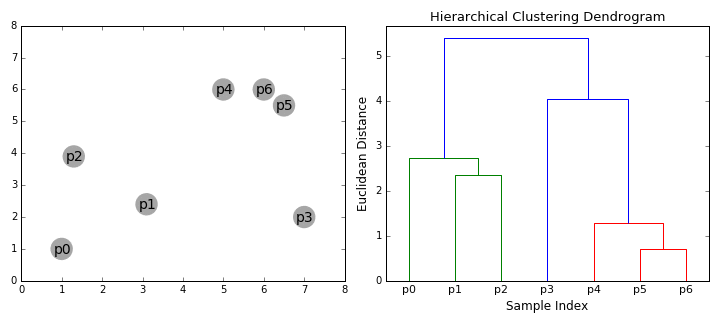

Как и в предыдущих алгоритмах кластеризации нам важно понимать какие объекты и кластеры считать *ближайшими*. Поэтому должны быть определены расстояния между объектами $R(x_i, x_j)$ и между кластерами $R(C_i, C_j)$


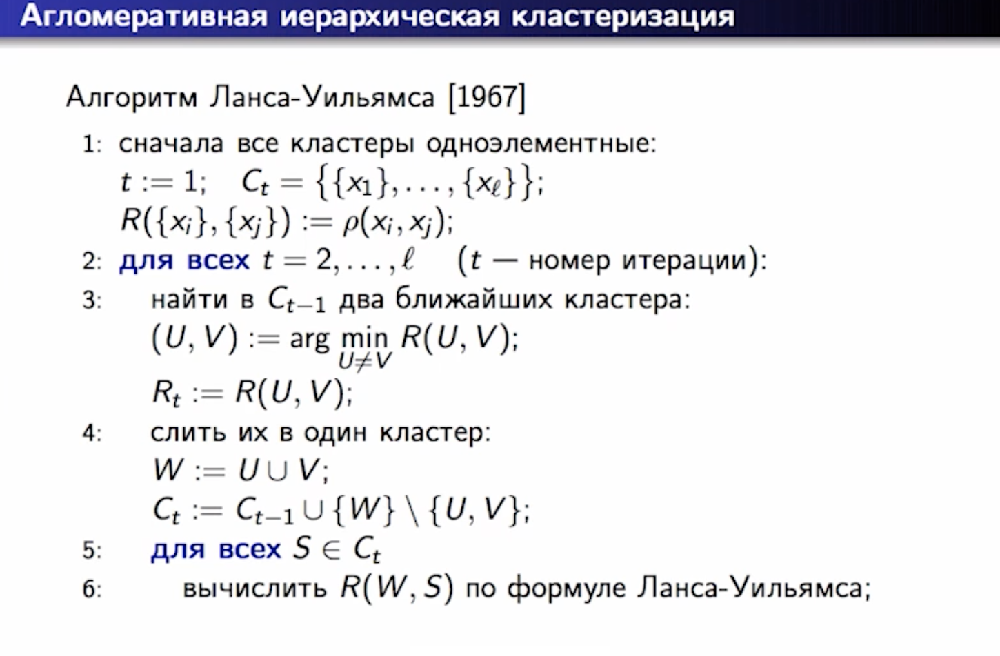

In [18]:
Image('images/hc1.png', width=1000)

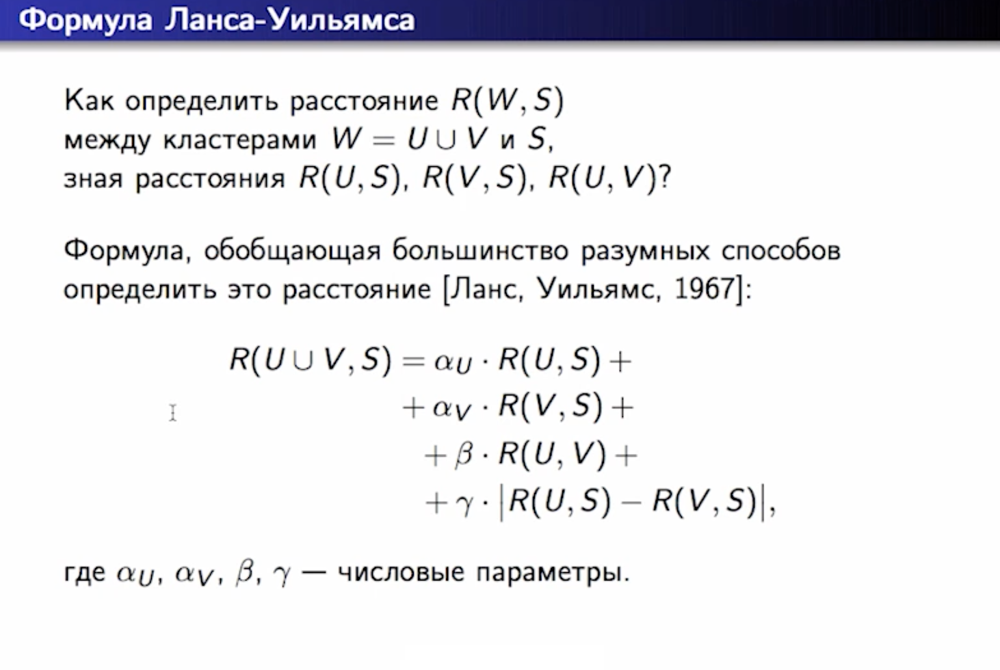

In [19]:
Image('images/hc2.png', width=1000)

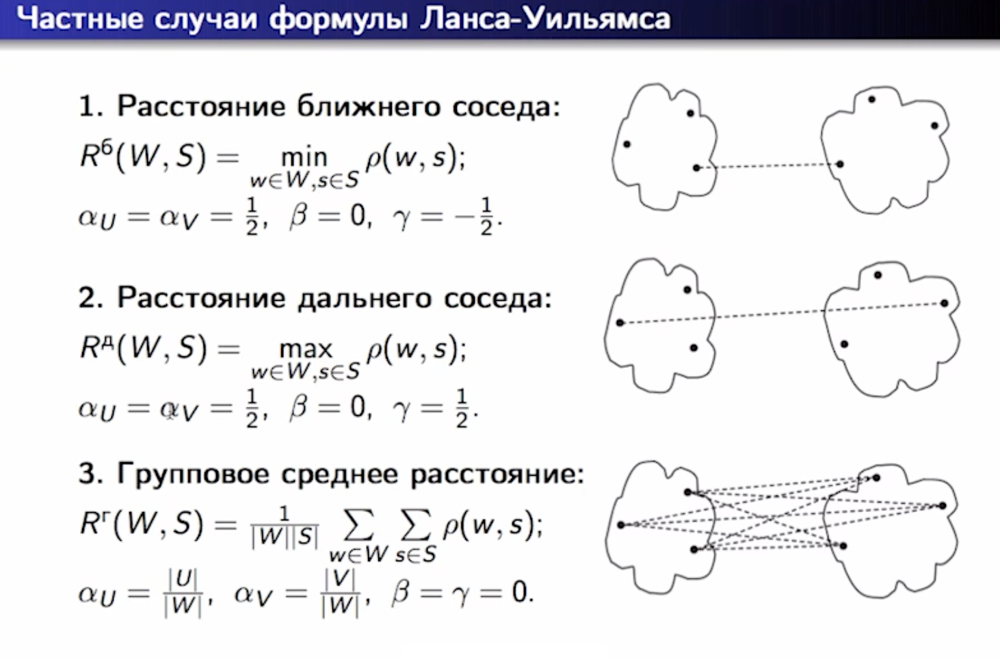

In [20]:
Image('images/hc3.png', width=1000)

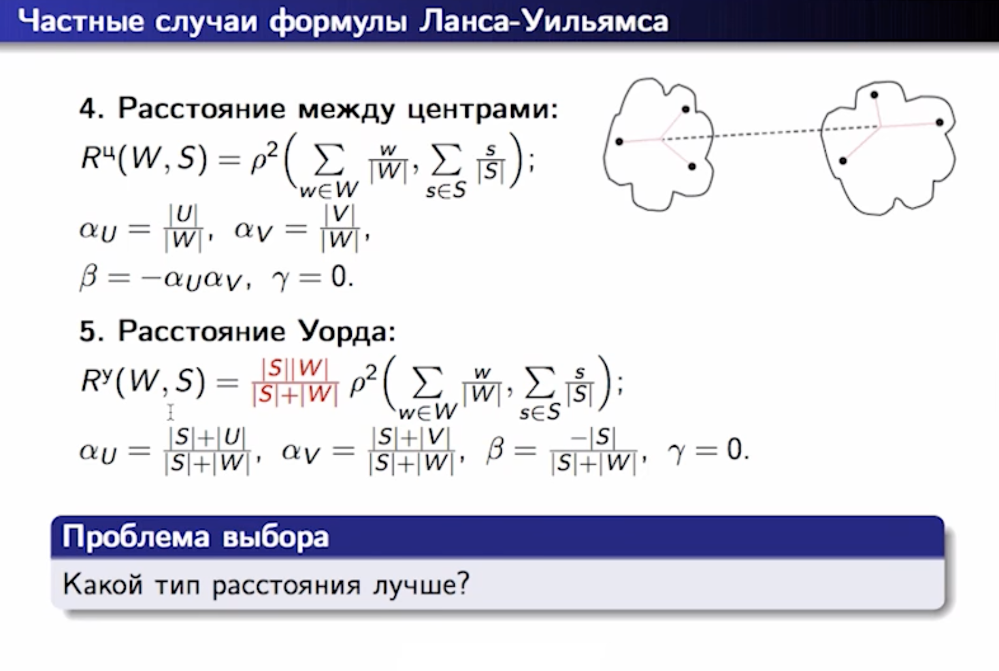

In [21]:
Image('images/hc4.png', width=1000)

[sklearn AgglomerativeClustering](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html)

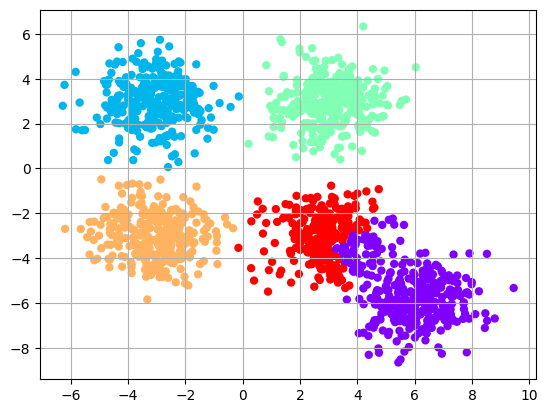

In [22]:
from sklearn.cluster import AgglomerativeClustering

cluster = AgglomerativeClustering(n_clusters=5,
                                  linkage='ward', #{‘ward’, ‘complete’, ‘average’, ‘single’},
                                 )
cluster.fit_predict(X5_example)



plt.scatter(X5_example[:,0],
            X5_example[:,1], 
            c = cluster.labels_, cmap='rainbow', edgecolors= 'none')
plt.grid()

## Линковка

In [23]:
# Наше множество объектов X
X = np.array([ [5, 3],[10,15], [15,12], [24,10], 
              [30,30],[85,70], [71,80], [60,78],
              [70,55], [80,91],])

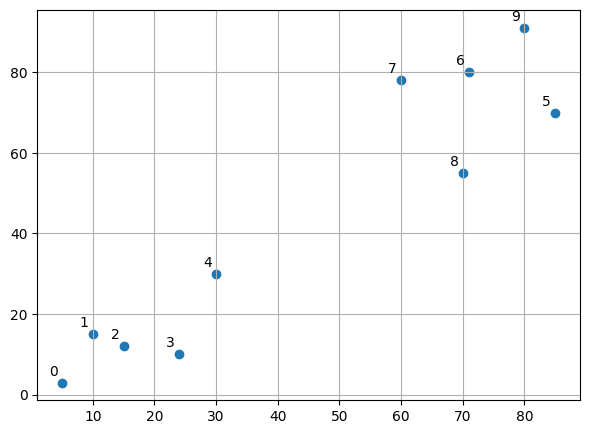

In [24]:
# Визаулизируем наши данные
# Видно, что здесь хорошо выделяются два кластера

labels = np.arange(0, len(X))
plt.figure(figsize=(7, 5))
plt.subplots_adjust(bottom=0.1)
plt.scatter(X[:,0],X[:,1], label='True Position')

for label, x, y in zip(labels, X[:, 0], X[:, 1]):
    plt.annotate(
        label,
        xy=(x, y), xytext=(-3, 3),
        textcoords='offset points', ha='right', va='bottom')
plt.grid()

In [25]:
# Произведем иерархическую кластеризацию

cluster = AgglomerativeClustering(n_clusters=2)
cluster.fit_predict(X)
cluster.labels_

array([1, 1, 1, 1, 1, 0, 0, 0, 0, 0])

In [26]:
from scipy.cluster.hierarchy import linkage, dendrogram

In [27]:
linked = linkage(X, 'ward')
linked

array([[  1.        ,   2.        ,   5.83095189,   2.        ],
       [  6.        ,   7.        ,  11.18033989,   2.        ],
       [  3.        ,  10.        ,  13.88044188,   3.        ],
       [  0.        ,  12.        ,  17.98147195,   4.        ],
       [  5.        ,   8.        ,  21.21320344,   2.        ],
       [  9.        ,  11.        ,  21.73323108,   3.        ],
       [  4.        ,  13.        ,  32.79634126,   5.        ],
       [ 14.        ,  15.        ,  33.64322616,   5.        ],
       [ 16.        ,  17.        , 185.44001726,  10.        ]])

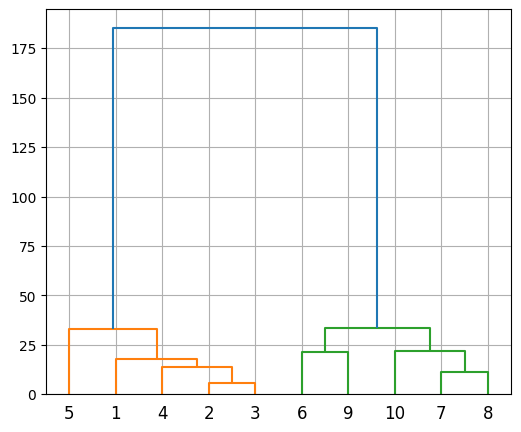

In [28]:
# Визуализируем дерево

labelList = np.arange(1, len(X) + 1)

plt.figure(figsize=(6, 5))
dendrogram(linked,
            orientation='top',
            labels=labelList,
            distance_sort='ascending',
            show_leaf_counts=True)
plt.grid()

Параметры ```count_sort``` и ```distance_sort``` отвечают за порядок построения дерева, ```orientation``` за его ориентацию.

Более детально [тут](https://docs.scipy.org/doc/scipy/reference/generated/scipy.cluster.hierarchy.dendrogram.html).

## Дендрограмма для agglomerative

In [29]:
# instantiate Agglomerative Clustering instance
clustering_model = AgglomerativeClustering(distance_threshold=0, 
                                           n_clusters=None)

# call fit method with array of sample coordinates passed as a parameter
trained_model = clustering_model.fit(X)

trained_model.children_

array([[ 1,  2],
       [ 6,  7],
       [ 3, 10],
       [ 0, 12],
       [ 5,  8],
       [ 9, 11],
       [ 4, 13],
       [14, 15],
       [16, 17]])

In [30]:
trained_model.distances_

array([  5.83095189,  11.18033989,  13.88044188,  17.98147195,
        21.21320344,  21.73323108,  32.79634126,  33.64322616,
       185.44001726])

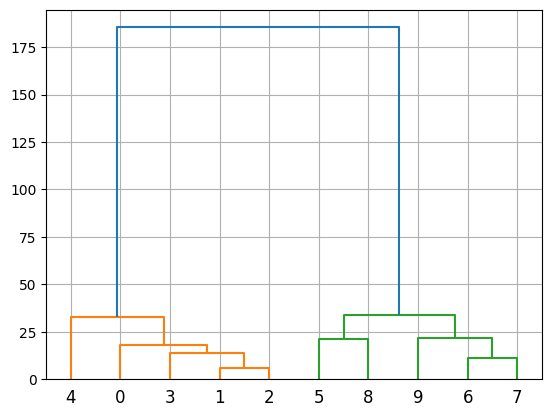

In [31]:

# instantiate Agglomerative Clustering instance
clustering_model = AgglomerativeClustering(distance_threshold=0, 
                                           n_clusters=None)

# call fit method with array of sample coordinates passed as a parameter
trained_model = clustering_model.fit(X)


# A method for generating dendrogram
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_, counts]).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)


# plot dendrogram to visualize clusters
plot_dendrogram(trained_model)
plt.grid()
plt.show()

## EM-алгоритм кластеризации (Expectation-Maximization)

Предположим, что у нас есть некоторое множество точек $X$

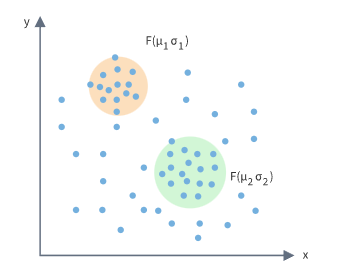

В основе EM-алгоритма лежит предположение, что наше множество $X$ может быть описано с помощью *Гауссовой смеси* (функции, состоящей из нескольких гауссиан). 

Рассмотрим более подробно случай, если у нас есть два кластера, каждый из которых описывается своей гауссианой $p(\mu_1, \sigma_1)$ и $p(\mu_2, \sigma_2)$.

Распределение всех точек, можно сосчитать так:

$$\mathbb{P}(x) = \alpha p_1(x) + (1 - \alpha) p_2(x)$$

Нашей целью является оценка параметров распределения, максимизирующих логарифмическую функцию правдоподобия.

По сути, нам надо максимизировать вот такую величину:

$$\prod\limits_{i = 1}^N\alpha f_1(x_i|\mu_2, \sigma_2) + (1 - \alpha) f_2(x_i|\mu_2, \sigma_2) \underset{(\mu_1, \mu_2, \sigma_1, \sigma_2, \alpha)}{\longrightarrow} max$$

Максимизировать конструкцию, которая написана выше довольно **сложно**, так как она представляет из себя композицию гауссиан. Однако, что нам мешает максимизировать одну гауссиану? На самом деле, мы не знаем к какому кластеру какой объект из $X$ принадлежит.

Вот если бы мы знали величину $y_n = \begin{cases}
   1 & x_n \in C_1\\
   0 & x_n \in C_2
 \end{cases}$, которая символизирует к какому кластеру относится конкретный объект.

Тогда нам бы пришлось максимизировать уже вот такую величину:

$$\mathbb{P}(x, y | \mu_1, \mu_2, \sigma_1, \sigma_2, \alpha)  =  \prod\limits_{i = 1}^N (\alpha f_1(x_i|\mu_1, \sigma_1))^{y_n} ((1-\alpha) f_2(x_i|\mu_2, \sigma_2))^{1 - y_n}$$

$$ln\mathbb{P}(x, y | \mu_1, \mu_2, \sigma_1, \sigma_2, \alpha) = \ \sum\limits_{n = 1}^N{y_n ln f_1(x_n)} + \sum\limits_{n = 1}^N{(1 - y_n) ln f_2(x_n)} + \sum\limits_{n = 1}^N{y_n ln\alpha + (1-y_n)ln(1-\alpha)} $$
 

Теперь переходим к сути алгоритма:

$ \theta$ - вектор параметров

Алгоритм состоит из двух шагов:

1. E_step: считаем y, при фиксированном $\theta$ 

$$\mathbb{E}y_n^{(m)} = \mathbb{E}_{\theta^{(m)}}y_n$$

2. M_step: считаем $\theta$, при фиксированных $y$ 
$$\theta^{(m + 1)} = \underset{\theta} {\arg\max} \ \mathbb{P}(x, y^{(m)} | \theta)$$

Еще понятнее (нет 🙃)

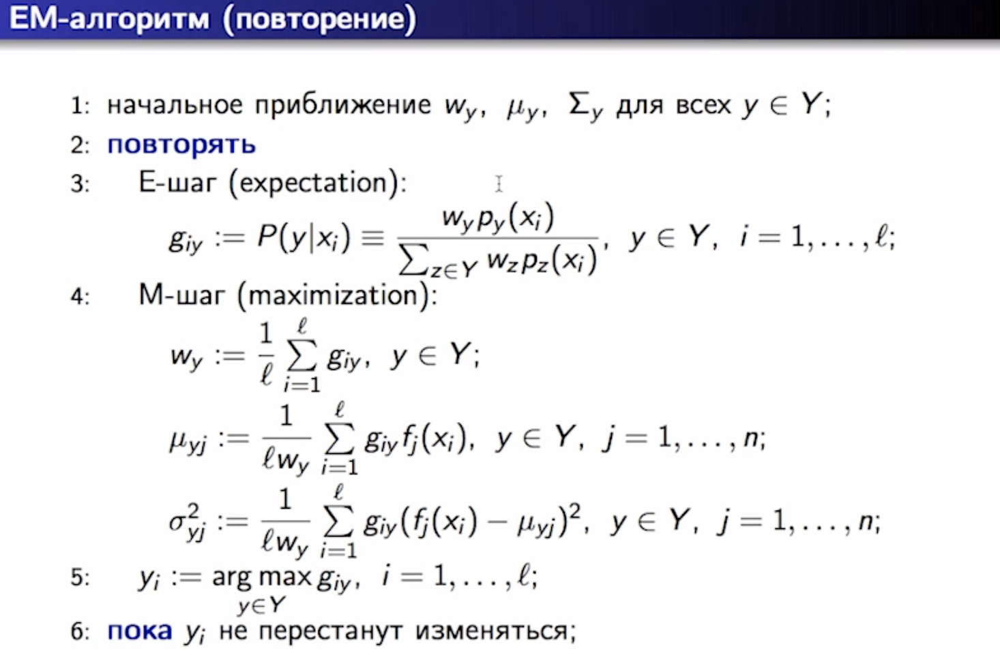

In [32]:
Image('images/em1.png', width=750)

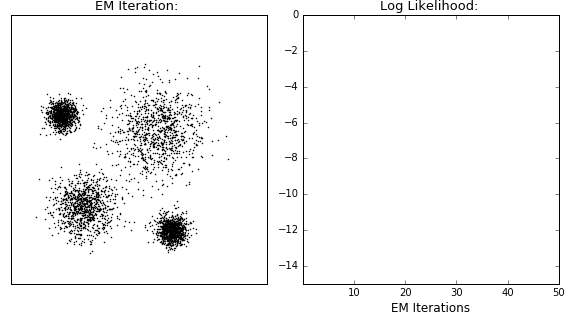

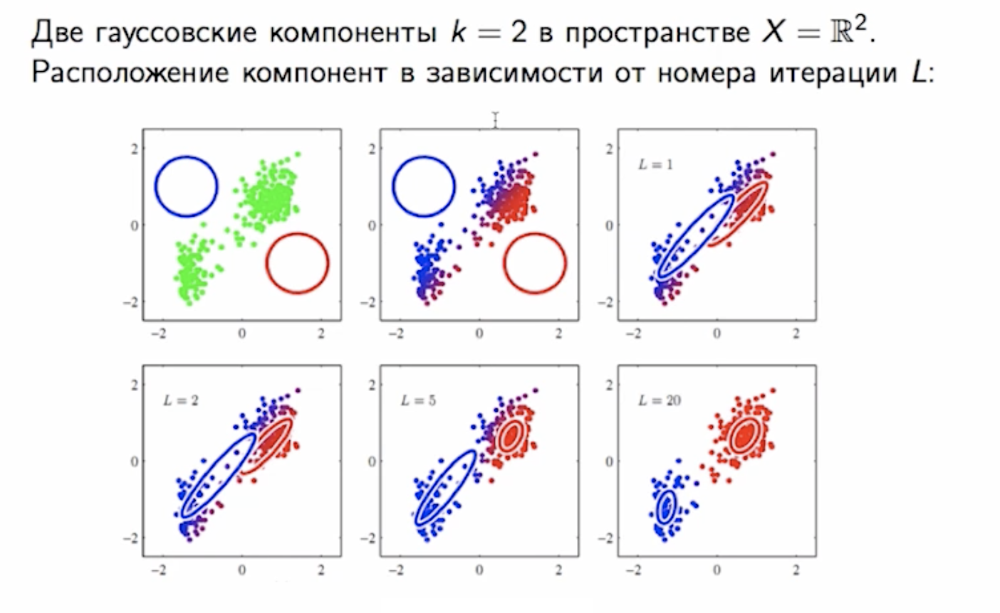

In [33]:
Image('images/em2.png', width=1000)

Таким образом, алгоритм определяет вероятность принадлежности какого-то объекта $x \in X$ к некоторому кластеру $C$. Полученные вероятности и являются результатом работы EM-алгоритма.

Обычно, объект $x$ относят к тому кластеру, для которого найденная вероятность выше.

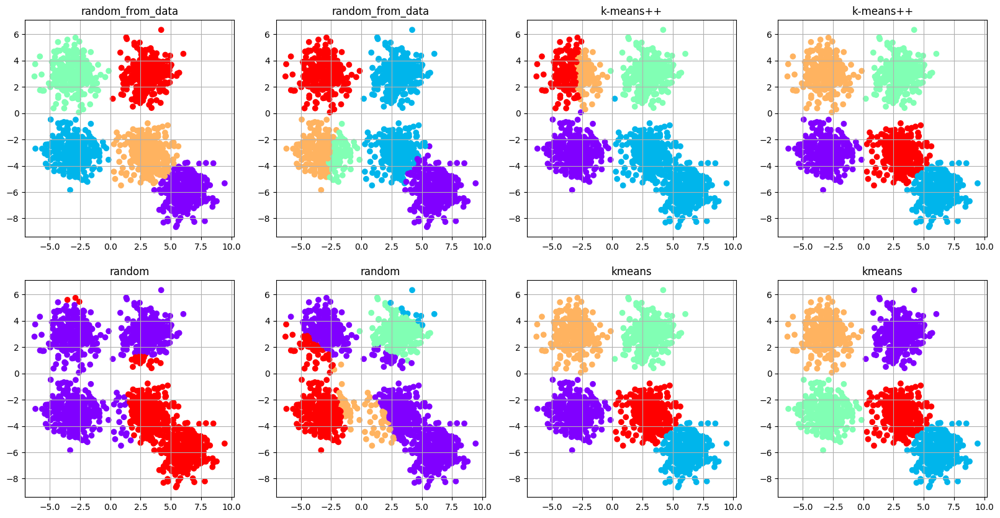

In [34]:
from sklearn.mixture import GaussianMixture
# GaussianMixture - это и есть Гауссова смесь
# The GaussianMixture object implements the expectation-maximization (EM) algorithm 
# for fitting mixture-of-Gaussian models. 
fig, axes = plt.subplots(2,4, figsize=(20,10))
axes = axes.flatten()

for ax, init in zip(axes[::2], ['random_from_data', 'k-means++', 'random', 'kmeans']):
    gmm = GaussianMixture(n_components=5,init_params=init).fit(X5_example)
    labels = gmm.predict(X5_example)
    ax.scatter(X5_example[:,0], X5_example[:,1], c=labels, cmap='rainbow')
    ax.grid()
    ax.set_title(init)

for ax, init in zip(axes[1::2], ['random_from_data', 'k-means++', 'random', 'kmeans']):
    gmm = GaussianMixture(n_components=5,init_params=init).fit(X5_example)
    labels = gmm.predict(X5_example)
    ax.scatter(X5_example[:,0], X5_example[:,1], c=labels, cmap='rainbow')
    ax.grid()
    ax.set_title(init)

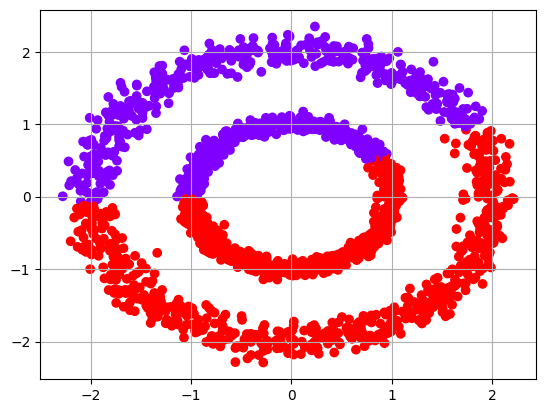

In [35]:
from sklearn.mixture import GaussianMixture
# GaussianMixture - это и есть Гауссова смесь
# The GaussianMixture object implements the expectation-maximization (EM) algorithm 
# for fitting mixture-of-Gaussian models. 

gmm = GaussianMixture(n_components=2,
                      max_iter=20,
                      init_params='random').fit(X_circle)

labels = gmm.predict(X_circle)

plt.scatter(X_circle[:,0], X_circle[:,1], c=labels, cmap='rainbow')
plt.grid()

## Ссылки

* [Хабр DBSCAN](https://habr.com/ru/post/322034/)
* [Хабр Affinity Propagation](https://habr.com/en/post/321216/)
* [Кластеризация от Воронцова](https://www.youtube.com/watch?v=UTm2-G3VeQQ&list=PLJOzdkh8T5krxc4HsHbB8g8f0hu7973fK&index=12)